In [ ]:
!pip install pyshp

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 kB 3.5 MB/s eta 0:00:00


In [ ]:
!pip install mapclassify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 55.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 101.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 120.9 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import shapefile as shp
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point
from shapely.geometry import LineString
from shapely.geometry.polygon import Polygon
import mapclassify as mc
from scipy import ndimage
import geopandas as gpd
import os
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

In [ ]:
shp_path ='/content/drive/MyDrive/LocData/LocData.shp'
df_TRT_shp = gpd.read_file(shp_path)
df_TRT_shp.head()

,GID,ID,GROUPNAME,JURISDICTI,ADDRESSID,COMMENTS,PRIVILEGEL,HEIGHT,MODIFIEDDA,MODIFIEDUS,CREATEDDAT,CREATEDUSE,ROTATION,GLOBALID,geometry
0,4549,Permanente Creek Trail - MPROSD,MPROSD,Santa Clara County,0,Rancho San Antonio Preserve - Access Via 22500...,2,40.0,2017-05-11,jgray,2017-05-11,jgray,0.0,{43E47C61-8A9B-48CA-87DA-65D1EF1F1CA8},POINT (6100470.500 1946253.000)
1,4550,Permanente Creek Trail/Amphitheatre,Permanente Creek Trail,Mountain View,0,NaN,1,8.0,2014-01-09,jgray,2014-01-09,jgray,0.0,{87E26882-6FF0-4C85-A17D-34EB8BA76048},POINT (6101012.000 1980538.000)
2,4551,Permanente Creek Trail/Charleston,Permanente Creek Trail,Mountain View,0,NaN,1,6.0,2014-01-09,jgray,2014-01-09,jgray,0.0,{05581C0E-7CFE-4663-A5F2-A28D3719910C},POINT (6100974.000 1979690.000)
3,4552,Permanente Creek Trail/Gate access to trail,Permanente Creek Trail,Mountain View,0,Gate access to trail (may/may not be locked). ...,1,1.0,2014-01-09,jgray,2014-01-09,jgray,0.0,{11A58DCC-4E30-491E-B8A5-EC8F90937AA9},POINT (6100948.500 1979635.500)
4,4553,Permanente Creek Trail/N Of Amphitheatre,Permanente Creek Trail,Mountain View,0,NaN,1,10.0,2014-01-09,jgray,2014-01-09,jgray,0.0,{6AF11DED-AC2C-461F-9308-BF5C5604358D},POINT (6101062.000 1982609.000)


In [ ]:
shp_path ='/content/drive/MyDrive/tl_2019_19147_edges/tl_2019_19147_edges.shp'
df_TRT_shp = gpd.read_file(shp_path)
df_TRT_shp.head()

,STATEFP,COUNTYFP,TLID,TFIDL,TFIDR,MTFCC,FULLNAME,SMID,LFROMADD,LTOADD,...,TTYP,DECKEDROAD,ARTPATH,PERSIST,GCSEFLG,OFFSETL,OFFSETR,TNIDF,TNIDT,geometry
0,19,147,9883812,266281960,266281949,S1400,480th St,1938,3844,3822,...,NaN,N,N,NaN,N,N,N,51457731,51457732,"LINESTRING (-94.82749 42.95255, -94.83043 42.9..."
1,19,147,9883610,203606563,266281960,S1400,490th St,1938,3898,3846,...,NaN,N,N,NaN,N,N,N,51457630,51457631,"LINESTRING (-94.82771 42.93812, -94.82953 42.9..."
2,19,147,9883611,203606563,266281960,S1400,490th St,1938,NaN,NaN,...,NaN,N,N,NaN,N,N,N,51457631,51453938,"LINESTRING (-94.83089 42.93814, -94.83200 42.9..."
3,19,147,9883810,266281960,203606675,S1400,480th St,1938,3848,3846,...,NaN,N,N,NaN,N,N,N,51457730,51457731,"LINESTRING (-94.82705 42.95255, -94.82749 42.9..."
4,19,147,9883608,203606563,266281960,S1400,490th St,1938,NaN,NaN,...,NaN,N,N,NaN,N,N,N,51453937,51457630,"LINESTRING (-94.82626 42.93811, -94.82661 42.9..."


In [ ]:
df_TRT_shp.columns

Index(['STATEFP', 'COUNTYFP', 'TLID', 'TFIDL', 'TFIDR', 'MTFCC', 'FULLNAME',
       'SMID', 'LFROMADD', 'LTOADD', 'RFROMADD', 'RTOADD', 'ZIPL', 'ZIPR',
       'FEATCAT', 'HYDROFLG', 'RAILFLG', 'ROADFLG', 'OLFFLG', 'PASSFLG',
       'EXTTYP', 'TTYP', 'DECKEDROAD', 'ARTPATH', 'PERSIST', 'GCSEFLG',
       'OFFSETL', 'OFFSETR', 'TNIDF', 'TNIDT', 'geometry'],
      dtype='object')

In [ ]:
shp_path_1 ='/content/drive/MyDrive/tl_2022_06_tract/tl_2022_06_tract.shp'
df_TRT_shp_1 = gpd.read_file(shp_path_1)
df_TRT_shp_1.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,037,137504,06037137504,1375.04,Census Tract 1375.04,G5020,S,3837562,0,+34.1480383,-118.5720594,"POLYGON ((-118.58119 34.14318, -118.58099 34.1..."
1,06,037,138000,06037138000,1380,Census Tract 1380,G5020,S,4472196,0,+34.1488008,-118.5910495,"POLYGON ((-118.60573 34.14585, -118.60561 34.1..."
2,06,037,139200,06037139200,1392,Census Tract 1392,G5020,S,1152028,0,+34.1756961,-118.5246446,"POLYGON ((-118.53082 34.18024, -118.52952 34.1..."
3,06,087,120901,06087120901,1209.01,Census Tract 1209.01,G5020,S,18372491,0,+37.0781624,-122.0154263,"POLYGON ((-122.04607 37.07105, -122.04505 37.0..."
4,06,087,120902,06087120902,1209.02,Census Tract 1209.02,G5020,S,6474889,0,+37.0628452,-122.0106243,"POLYGON ((-122.02513 37.04320, -122.02500 37.0..."


In [ ]:
shp_path ='/content/drive/MyDrive/tl_2022_06_tabblock20/tl_2022_06_tabblock20.shp'
df_TRT_shp = gpd.read_file(shp_path)
df_TRT_shp.head()

,STATEFP20,COUNTYFP20,TRACTCE20,BLOCKCE20,GEOID20,NAME20,MTFCC20,UR20,UACE20,UATYPE20,FUNCSTAT20,ALAND20,AWATER20,INTPTLAT20,INTPTLON20,HOUSING20,POP20,geometry
0,06,017,030711,3009,060170307113009,Block 3009,G5040,NaN,NaN,NaN,S,60168,0,+38.6564057,-121.0553090,0,0,"POLYGON ((-121.05698 38.65731, -121.05692 38.6..."
1,06,017,031800,4013,060170318004013,Block 4013,G5040,NaN,NaN,NaN,S,7341,0,+38.6577682,-121.0556814,0,0,"POLYGON ((-121.05711 38.65754, -121.05659 38.6..."
2,06,017,031800,4012,060170318004012,Block 4012,G5040,NaN,NaN,NaN,S,109082,0,+38.6596828,-121.0567416,0,0,"POLYGON ((-121.05892 38.66184, -121.05876 38.6..."
3,06,017,031406,5022,060170314065022,Block 5022,G5040,NaN,NaN,NaN,S,97513,0,+38.7036127,-120.6074365,18,42,"POLYGON ((-120.60904 38.70229, -120.60892 38.7..."
4,06,017,030603,1017,060170306031017,Block 1017,G5040,NaN,NaN,NaN,S,915283,0,+38.8699744,-120.8301279,18,36,"POLYGON ((-120.83376 38.86137, -120.83375 38.8..."


In [ ]:
df_x = df_TRT_shp[df_TRT_shp['COUNTYFP20']=='085']

In [ ]:
df_x['CTNAME'] = range(1, len(df_x) + 1)
df_x

/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,STATEFP20,COUNTYFP20,TRACTCE20,BLOCKCE20,GEOID20,NAME20,MTFCC20,UR20,UACE20,UATYPE20,FUNCSTAT20,ALAND20,AWATER20,INTPTLAT20,INTPTLON20,HOUSING20,POP20,geometry,CTNAME
7033,06,085,512602,1027,060855126021027,Block 1027,G5040,NaN,NaN,NaN,S,700844,0,+37.0294100,-121.5334257,15,48,"POLYGON ((-121.53934 37.03195, -121.53924 37.0...",1
7034,06,085,512602,1028,060855126021028,Block 1028,G5040,NaN,NaN,NaN,S,2773007,0,+37.0106885,-121.5320793,58,187,"POLYGON ((-121.54346 37.01876, -121.54344 37.0...",2
7035,06,085,512602,2020,060855126022020,Block 2020,G5040,NaN,NaN,NaN,S,175787,0,+37.0415029,-121.5383461,18,73,"POLYGON ((-121.54197 37.04175, -121.54156 37.0...",3
7036,06,085,512602,1004,060855126021004,Block 1004,G5040,NaN,NaN,NaN,S,276087,0,+37.0348031,-121.5411507,3,26,"POLYGON ((-121.54446 37.03571, -121.54412 37.0...",4
7037,06,085,512602,2009,060855126022009,Block 2009,G5040,NaN,NaN,NaN,S,695350,0,+37.0388863,-121.5289809,30,88,"POLYGON ((-121.53937 37.03706, -121.53881 37.0...",5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
370843,06,085,511911,2008,060855119112008,Block 2008,G5040,NaN,NaN,NaN,S,1598456,0,+37.2085268,-121.8111865,0,0,"POLYGON ((-121.82370 37.20722, -121.82360 37.2...",18174
370844,06,085,511911,3003,060855119113003,Block 3003,G5040,NaN,NaN,NaN,S,1232345,0,+37.2242955,-121.8290026,24,68,"POLYGON ((-121.84074 37.22537, -121.84015 37.2...",18175
370845,06,085,511911,3017,060855119113017,Block 3017,G5040,NaN,NaN,NaN,S,365524,0,+37.2218145,-121.8383225,48,103,"POLYGON ((-121.84293 37.22361, -121.84279 37.2...",18176
370846,06,085,512305,1022,060855123051022,Block 1022,G5040,NaN,NaN,NaN,S,13075,0,+37.1394585,-121.6688175,18,54,"POLYGON ((-121.66950 37.14001, -121.66933 37.1...",18177


In [ ]:
df_x['ALAND20'] = df_x['ALAND20']/1000000
df_x['pop_den'] = (df_x['POP20']/df_x['ALAND20'])
df_x[['POP20','ALAND20','pop_den']].head()


/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/usr/local/lib/python3.10/dist-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,POP20,ALAND20,pop_den
7033,48,0.700844,68.488851
7034,187,2.773007,67.435820
7035,73,0.175787,415.275305
7036,26,0.276087,94.173214
7037,88,0.695350,126.554972


In [ ]:
df_x.loc[df_x['pop_den'].isnull(),'pop_den']=0
df_x_2 = df_x[['POP20', 'geometry', 'ALAND20', 'pop_den']].copy()
df_x_2.head()

,POP20,geometry,ALAND20,pop_den
7033,48,"POLYGON ((-121.53934 37.03195, -121.53924 37.0...",0.700844,68.488851
7034,187,"POLYGON ((-121.54346 37.01876, -121.54344 37.0...",2.773007,67.435820
7035,73,"POLYGON ((-121.54197 37.04175, -121.54156 37.0...",0.175787,415.275305
7036,26,"POLYGON ((-121.54446 37.03571, -121.54412 37.0...",0.276087,94.173214
7037,88,"POLYGON ((-121.53937 37.03706, -121.53881 37.0...",0.695350,126.554972


In [ ]:
df_x_2.plot(figsize=(12,10),column='pop_den',cmap='OrRd', scheme='quantiles')

<Axes: >

In [ ]:
df_chg_stn = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_charging.xlsx')
df_chg_stn.head()

,Unnamed: 0,ID,Name,latitude,longitude,Rating,Url
0,0,ChIJJ_i4Doqlj4ARqQWRfSgHFkA,Tesla Supercharger,37.423409,-122.198220,4.7,https://maps.google.com/?cid=4617886338401764777
1,1,ChIJ61tKqMSkj4ARaR0LLXA4q98,ChargePoint Charging Station,37.431131,-122.191541,0.0,https://maps.google.com/?cid=16117037745918647657
2,2,ChIJk0PtJeekj4ARfaZKdgK1_C0,Shell Recharge Charging Station,37.424051,-122.199707,0.0,https://maps.google.com/?cid=3313722448017008253
3,3,ChIJ7cYPutGkj4AR1xRXUvW8irA,ChargePoint Charging Station,37.431730,-122.182068,0.0,https://maps.google.com/?cid=12721187859295835351
4,4,ChIJcY77a-ekj4ARkHGl4H6ReEU,ChargePoint Charging Station,37.425283,-122.198397,0.0,https://maps.google.com/?cid=5005910959943152016


In [ ]:
def df_to_gdf(df):
    """takes a dataframe with columns named 'longitude' and 'latitude' 
    to transform to a geodataframe with point features"""
    
    df['coordinates'] = df[['longitude', 'latitude']].values.tolist()
    df['coordinates'] = df['coordinates'].apply(Point)
    df = gpd.GeoDataFrame(df, geometry = 'coordinates')
    return df

In [ ]:
gdf_chg_stn = df_to_gdf(df_chg_stn)
gdf_chg_stn.head()

,Unnamed: 0,ID,Name,latitude,longitude,Rating,Url,coordinates
0,0,ChIJJ_i4Doqlj4ARqQWRfSgHFkA,Tesla Supercharger,37.423409,-122.198220,4.7,https://maps.google.com/?cid=4617886338401764777,POINT (-122.19822 37.42341)
1,1,ChIJ61tKqMSkj4ARaR0LLXA4q98,ChargePoint Charging Station,37.431131,-122.191541,0.0,https://maps.google.com/?cid=16117037745918647657,POINT (-122.19154 37.43113)
2,2,ChIJk0PtJeekj4ARfaZKdgK1_C0,Shell Recharge Charging Station,37.424051,-122.199707,0.0,https://maps.google.com/?cid=3313722448017008253,POINT (-122.19971 37.42405)
3,3,ChIJ7cYPutGkj4AR1xRXUvW8irA,ChargePoint Charging Station,37.431730,-122.182068,0.0,https://maps.google.com/?cid=12721187859295835351,POINT (-122.18207 37.43173)
4,4,ChIJcY77a-ekj4ARkHGl4H6ReEU,ChargePoint Charging Station,37.425283,-122.198397,0.0,https://maps.google.com/?cid=5005910959943152016,POINT (-122.19840 37.42528)


<Axes: >

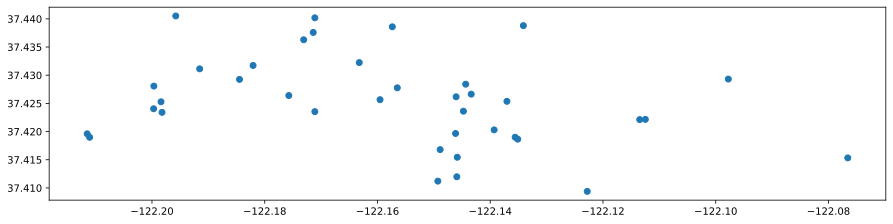

In [ ]:
gdf_chg_stn.plot(figsize=(15,10))

In [ ]:
df_foodcourt = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_foodcourt.xlsx')
df_gas = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_gas.xlsx')
df_grocery = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_grocery.xlsx')
#df_parking = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_parking.xlsx')
#df_restaurant = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_restaurant.xlsx')
df_shopping = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_shopping.xlsx')
#df_university = pd.read_excel('/content/drive/MyDrive/295A Project/data/raw/TRT_university.xlsx')

In [ ]:
gdf_foodcourt = df_to_gdf(df_foodcourt)
gdf_gas = df_to_gdf(df_gas)
gdf_grocery = df_to_gdf(df_grocery)
# gdf_parking = df_to_gdf(df_parking)
# gdf_restaurant = df_to_gdf(df_restaurant)
gdf_shopping = df_to_gdf(df_shopping)
# gdf_university = df_to_gdf(df_university)

<Axes: >

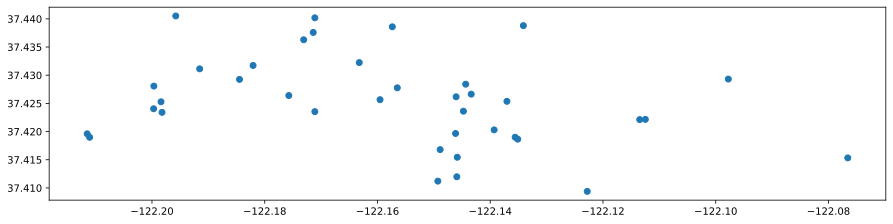

In [ ]:
gdf_chg_stn.plot(figsize=(15,10))

In [ ]:
df_x.head()

,STATEFP20,COUNTYFP20,TRACTCE20,BLOCKCE20,GEOID20,NAME20,MTFCC20,UR20,UACE20,UATYPE20,FUNCSTAT20,ALAND20,AWATER20,INTPTLAT20,INTPTLON20,HOUSING20,POP20,geometry,CTNAME,pop_den
7033,06,085,512602,1027,060855126021027,Block 1027,G5040,NaN,NaN,NaN,S,0.700844,0,+37.0294100,-121.5334257,15,48,"POLYGON ((-121.53934 37.03195, -121.53924 37.0...",1,68.488851
7034,06,085,512602,1028,060855126021028,Block 1028,G5040,NaN,NaN,NaN,S,2.773007,0,+37.0106885,-121.5320793,58,187,"POLYGON ((-121.54346 37.01876, -121.54344 37.0...",2,67.435820
7035,06,085,512602,2020,060855126022020,Block 2020,G5040,NaN,NaN,NaN,S,0.175787,0,+37.0415029,-121.5383461,18,73,"POLYGON ((-121.54197 37.04175, -121.54156 37.0...",3,415.275305
7036,06,085,512602,1004,060855126021004,Block 1004,G5040,NaN,NaN,NaN,S,0.276087,0,+37.0348031,-121.5411507,3,26,"POLYGON ((-121.54446 37.03571, -121.54412 37.0...",4,94.173214
7037,06,085,512602,2009,060855126022009,Block 2009,G5040,NaN,NaN,NaN,S,0.695350,0,+37.0388863,-121.5289809,30,88,"POLYGON ((-121.53937 37.03706, -121.53881 37.0...",5,126.554972


In [ ]:
selected_cols = ['CTNAME','ALAND20','pop_den', 'geometry']

In [ ]:
pop_den = df_x[selected_cols]
pop_den.head()

,CTNAME,ALAND20,pop_den,geometry
7033,1,0.700844,68.488851,"POLYGON ((-121.53934 37.03195, -121.53924 37.0..."
7034,2,2.773007,67.435820,"POLYGON ((-121.54346 37.01876, -121.54344 37.0..."
7035,3,0.175787,415.275305,"POLYGON ((-121.54197 37.04175, -121.54156 37.0..."
7036,4,0.276087,94.173214,"POLYGON ((-121.54446 37.03571, -121.54412 37.0..."
7037,5,0.695350,126.554972,"POLYGON ((-121.53937 37.03706, -121.53881 37.0..."


In [ ]:
def cal_dist(lat1, lon1, lat2, lon2):
    radius = 6371 # km, earth radius

    dlat = np.radians(lat2-lat1)
    dlon = np.radians(lon2-lon1)
    a = np.sin(dlat/2) * np.sin(dlat/2) + np.cos(np.radians(lat1)) \
        * np.cos(np.radians(lat2)) * np.sin(dlon/2) * np.sin(dlon/2)
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    d = radius * c
    return d

lat_range = round(cal_dist(37.448814, -122.231756, 37.372963, -122.231756))
lat_range
#(37.476127, -122.221867, 37.380855, -122.073689)

8

In [ ]:
#(37.419584, -122.221318, 37.486086, -122.142697)
long_range = round(cal_dist(37.404983, -122.247526, 37.404983, -122.096099))
long_range
#42

13

In [ ]:
# try for now: setting the grid to be 100m*100m
lat_list = np.arange(37.372963,37.448814, (37.448814-37.372963)/(lat_range*10))
long_list = np.arange(-122.247526,  -122.096099, (122.247526-122.096099)/(long_range*10))
xx,yy = np.meshgrid(lat_list,long_list)
coord_grid = pd.DataFrame(np.array([xx, yy]).reshape(2,-1).T, columns = ['Lat', 'Lon'])
coord_grid['coord']=coord_grid[['Lon', 'Lat']].values.tolist()
coord_grid['coord'] = coord_grid['coord'].apply(Point)
coord_grid_gpd = gpd.GeoDataFrame(coord_grid, geometry = 'coord')
coord_grid.shape

(10400, 3)

In [ ]:
coord_grid.head()

,Lat,Lon,coord
0,37.372963,-122.247526,POINT (-122.24753 37.37296)
1,37.373911,-122.247526,POINT (-122.24753 37.37391)
2,37.374859,-122.247526,POINT (-122.24753 37.37486)
3,37.375807,-122.247526,POINT (-122.24753 37.37581)
4,37.376756,-122.247526,POINT (-122.24753 37.37676)


In [ ]:
coord_grid_gpd.crs = {'init' :'epsg:4326'}
pop_den.crs == coord_grid_gpd.crs

coord_grid_gpd = coord_grid_gpd.to_crs(pop_den.crs)

join = gpd.sjoin(coord_grid_gpd, pop_den, how="inner", op="within")
join.head()

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py:3473: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


,Lat,Lon,coord,index_right,CTNAME,ALAND20,pop_den
3360,37.372963,-122.198603,POINT (-122.19860 37.37296),12770,1067,0.468752,134.399427
3361,37.373911,-122.198603,POINT (-122.19860 37.37391),12770,1067,0.468752,134.399427
3362,37.374859,-122.198603,POINT (-122.19860 37.37486),12770,1067,0.468752,134.399427
3441,37.373911,-122.197439,POINT (-122.19744 37.37391),12770,1067,0.468752,134.399427
3442,37.374859,-122.197439,POINT (-122.19744 37.37486),12770,1067,0.468752,134.399427


In [ ]:
join.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 6355 entries, 3360 to 10380
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   Lat          6355 non-null   float64 
 1   Lon          6355 non-null   float64 
 2   coord        6355 non-null   geometry
 3   index_right  6355 non-null   int64   
 4   CTNAME       6355 non-null   int64   
 5   ALAND20      6355 non-null   float64 
 6   pop_den      6355 non-null   float64 
dtypes: float64(4), geometry(1), int64(2)
memory usage: 397.2 KB


In [ ]:
join.shape

(6355, 7)

In [ ]:
pop_den.shape 

(18178, 4)

In [ ]:
coord_grid_gpd['test']='testing'

In [ ]:
pop_den.head()

,CTNAME,ALAND20,pop_den,geometry
7033,1,0.700844,68.488851,"POLYGON ((-121.53934 37.03195, -121.53924 37.0..."
7034,2,2.773007,67.435820,"POLYGON ((-121.54346 37.01876, -121.54344 37.0..."
7035,3,0.175787,415.275305,"POLYGON ((-121.54197 37.04175, -121.54156 37.0..."
7036,4,0.276087,94.173214,"POLYGON ((-121.54446 37.03571, -121.54412 37.0..."
7037,5,0.695350,126.554972,"POLYGON ((-121.53937 37.03706, -121.53881 37.0..."


In [ ]:
dfsjoin = gpd.sjoin(pop_den, coord_grid_gpd)

In [ ]:
pop_den.set_index('CTNAME')
pop_den.head()

,CTNAME,ALAND20,pop_den,geometry
7033,1,0.700844,68.488851,"POLYGON ((-121.53934 37.03195, -121.53924 37.0..."
7034,2,2.773007,67.435820,"POLYGON ((-121.54346 37.01876, -121.54344 37.0..."
7035,3,0.175787,415.275305,"POLYGON ((-121.54197 37.04175, -121.54156 37.0..."
7036,4,0.276087,94.173214,"POLYGON ((-121.54446 37.03571, -121.54412 37.0..."
7037,5,0.695350,126.554972,"POLYGON ((-121.53937 37.03706, -121.53881 37.0..."


In [ ]:
dfpivot = pd.pivot_table(dfsjoin,index='CTNAME',columns='test',aggfunc={'test':len})

In [ ]:
dfpivot.columns = dfpivot.columns.droplevel()

In [ ]:
dfpivot.columns
dfpivot.head()

test,testing
CTNAME,
360,2
361,8
362,2
363,3
365,3


In [ ]:
dfpivot = dfpivot.reset_index(level = 'CTNAME')

In [ ]:
pop_den.head()

,CTNAME,ALAND20,pop_den,geometry
7033,1,0.700844,68.488851,"POLYGON ((-121.53934 37.03195, -121.53924 37.0..."
7034,2,2.773007,67.435820,"POLYGON ((-121.54346 37.01876, -121.54344 37.0..."
7035,3,0.175787,415.275305,"POLYGON ((-121.54197 37.04175, -121.54156 37.0..."
7036,4,0.276087,94.173214,"POLYGON ((-121.54446 37.03571, -121.54412 37.0..."
7037,5,0.695350,126.554972,"POLYGON ((-121.53937 37.03706, -121.53881 37.0..."


In [ ]:
dfpolynew = pop_den.merge(dfpivot, how='left',on='CTNAME')

In [ ]:

dfpolynew

,CTNAME,ALAND20,pop_den,geometry,testing
0,1,0.700844,68.488851,"POLYGON ((-121.53934 37.03195, -121.53924 37.0...",NaN
1,2,2.773007,67.435820,"POLYGON ((-121.54346 37.01876, -121.54344 37.0...",NaN
2,3,0.175787,415.275305,"POLYGON ((-121.54197 37.04175, -121.54156 37.0...",NaN
3,4,0.276087,94.173214,"POLYGON ((-121.54446 37.03571, -121.54412 37.0...",NaN
4,5,0.695350,126.554972,"POLYGON ((-121.53937 37.03706, -121.53881 37.0...",NaN
...,...,...,...,...,...
18173,18174,1.598456,0.000000,"POLYGON ((-121.82370 37.20722, -121.82360 37.2...",NaN
18174,18175,1.232345,55.179353,"POLYGON ((-121.84074 37.22537, -121.84015 37.2...",NaN
18175,18176,0.365524,281.787242,"POLYGON ((-121.84293 37.22361, -121.84279 37.2...",NaN
18176,18177,0.013075,4130.019120,"POLYGON ((-121.66950 37.14001, -121.66933 37.1...",NaN


In [ ]:
dfpolynew['testing'].describe()

count    1149.000000
mean        5.530896
std        15.981265
min         1.000000
25%         1.000000
50%         2.000000
75%         4.000000
max       274.000000
Name: testing, dtype: float64

In [ ]:
def ct_pts_in_plg(point, polygon, column_name, index_name):
    """Given point shapefile and polygon shapefile, count how many points are in each polygon"""
    point['has_feature'] = column_name
    point.crs = {'init' :'epsg:4326'}
    # re-project grid points to the population layer
    point = point.to_crs(polygon.crs)
    # spatial join
    dfsjoin = gpd.sjoin(polygon, point)
    polygon.set_index(index_name)
    dfpivot = pd.pivot_table(dfsjoin,index=index_name,columns='has_feature',aggfunc={'has_feature':len})
    dfpivot.columns = dfpivot.columns.droplevel()
    dfpivot = dfpivot.reset_index(level = index_name)
    dfpolynew = polygon.merge(dfpivot, how='left',on=index_name)
    dfpolynew.loc[dfpolynew[column_name].isnull(), column_name]=0
    return dfpolynew

In [ ]:
indexNames = dfpolynew[dfpolynew['testing'].isnull()].index
# Delete these row indexes from dataFrame
df_TRT_join_pts = dfpolynew.drop(indexNames)
df_TRT_join_chg = ct_pts_in_plg(gdf_chg_stn, df_TRT_join_pts, 'charging station', 'CTNAME')
df_TRT_join_chg['charging station'].describe() 

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


count    1149.000000
mean        0.023499
std         0.177981
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         3.000000
Name: charging station, dtype: float64

In [ ]:
df_TRT_join_chg.shape

(1149, 6)

In [ ]:
df_TRT_join_chg = ct_pts_in_plg(gdf_foodcourt, df_TRT_join_chg, 'food court', 'CTNAME')
df_TRT_join_chg['food court'].describe()  

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


count    1149.000000
mean        0.008703
std         0.101868
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: food court, dtype: float64

In [ ]:
df_TRT_join_chg = ct_pts_in_plg(gdf_gas, df_TRT_join_chg, 'gas stations', 'CTNAME')
df_TRT_join_chg['gas stations'].describe()

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


count    1149.000000
mean        0.008703
std         0.110088
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: gas stations, dtype: float64

In [ ]:
df_TRT_join_chg = ct_pts_in_plg(gdf_grocery, df_TRT_join_chg, 'grocery store', 'CTNAME')
df_TRT_join_chg['grocery store'].describe()

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


count    1149.000000
mean        0.009574
std         0.097417
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: grocery store, dtype: float64

In [ ]:
df_TRT_join_chg = ct_pts_in_plg(gdf_shopping, df_TRT_join_chg, 'shopping center', 'CTNAME')
df_TRT_join_chg['shopping center'].describe()

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


count    1149.000000
mean        0.006092
std         0.088332
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: shopping center, dtype: float64

In [ ]:
gdf_chg_stn.head()

,Unnamed: 0,ID,Name,latitude,longitude,Rating,Url,coordinates,has_feature
0,0,ChIJJ_i4Doqlj4ARqQWRfSgHFkA,Tesla Supercharger,37.423409,-122.198220,4.7,https://maps.google.com/?cid=4617886338401764777,POINT (-122.19822 37.42341),charging station
1,1,ChIJ61tKqMSkj4ARaR0LLXA4q98,ChargePoint Charging Station,37.431131,-122.191541,0.0,https://maps.google.com/?cid=16117037745918647657,POINT (-122.19154 37.43113),charging station
2,2,ChIJk0PtJeekj4ARfaZKdgK1_C0,Shell Recharge Charging Station,37.424051,-122.199707,0.0,https://maps.google.com/?cid=3313722448017008253,POINT (-122.19971 37.42405),charging station
3,3,ChIJ7cYPutGkj4AR1xRXUvW8irA,ChargePoint Charging Station,37.431730,-122.182068,0.0,https://maps.google.com/?cid=12721187859295835351,POINT (-122.18207 37.43173),charging station
4,4,ChIJcY77a-ekj4ARkHGl4H6ReEU,ChargePoint Charging Station,37.425283,-122.198397,0.0,https://maps.google.com/?cid=5005910959943152016,POINT (-122.19840 37.42528),charging station


In [ ]:
gdf_chg_stn['type'] = 'non Tesla chg'
gdf_chg_stn.loc[gdf_chg_stn['Name'].str.contains('Tesla Supercharger'),'type']='Tesla Supercharger'
gdf_chg_stn.loc[gdf_chg_stn['Name'].str.contains('Tesla Destination'), 'type']='Tesla Ordinary'
gdf_chg_stn.groupby('type')['type'].value_counts()

type                type              
Tesla Ordinary      Tesla Ordinary         2
Tesla Supercharger  Tesla Supercharger     2
non Tesla chg       non Tesla chg         34
Name: type, dtype: int64

In [ ]:
gdf_tesla_s = gdf_chg_stn[gdf_chg_stn['type']=='Tesla Supercharger'] # GeoDataFrame of Tesla Superchargers
gdf_tesla_s.shape

(2, 10)

In [ ]:
gdf_tesla_o = gdf_chg_stn[gdf_chg_stn['type']=='Tesla Ordinary'] # GeoDataFrame of Tesla Ordinary Chargers
gdf_tesla_o.shape

(2, 10)

In [ ]:
gdf_nontesla = gdf_chg_stn[gdf_chg_stn['type']=='non Tesla chg'] # GeoDataFrame of non Tesla Chargers
gdf_nontesla.shape

(34, 10)

In [ ]:
y_lim = ( 37.372963, 37.448814) # latitude (boundaries of city of TRT)
x_lim = (-122.221318, -122.096099) # longitude (boundaries of city of TRT)

base = df_x_2.plot(figsize=(12,10),column='pop_den',cmap='OrRd', scheme='quantiles')
base.set_xlim(x_lim)
base.set_ylim(y_lim)
#df_expy.plot(ax = base, color = 'blue')
gdf_nontesla.plot(ax=base, color = 'green', markersize = 15, alpha=0.6)
gdf_tesla_s.plot(ax=base, color = 'yellow', marker = '*', markersize = 20, alpha=0.6)
gdf_tesla_o.plot(ax=base, color = 'cyan', marker = 'D', markersize = 15, alpha=0.6)
plt.savefig('graphs/Density_chg_hwy_overlayed.pdf')

FileNotFoundError: ignored

In [ ]:
df_TRT_join_chg.head()

,CTNAME,ALAND20,pop_den,geometry,testing,charging station,food court,gas stations,grocery store,shopping center
0,360,0.020245,3358.854038,"POLYGON ((-122.12240 37.41363, -122.12205 37.4...",2.0,0.0,0.0,0.0,0.0,0.0
1,361,0.073715,5846.842569,"POLYGON ((-122.12466 37.41321, -122.12438 37.4...",8.0,0.0,0.0,0.0,0.0,0.0
2,362,0.018425,922.659430,"POLYGON ((-122.12663 37.41461, -122.12645 37.4...",2.0,0.0,0.0,0.0,0.0,0.0
3,363,0.029938,6413.254058,"POLYGON ((-122.12572 37.41462, -122.12556 37.4...",3.0,0.0,0.0,0.0,0.0,0.0
4,365,0.038152,6657.580205,"POLYGON ((-122.12814 37.41584, -122.12786 37.4...",3.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
df_TRT_join_chg['has_food_court']=0
df_TRT_join_chg.loc[df_TRT_join_chg['food court']>0,'has_food_court']=1

In [ ]:
counts, xdges, yedges = np.histogram2d(gdf_chg_stn['latitude'], gdf_chg_stn['longitude'], bins = 30)

(array([[0., 0., 0., 0., 2., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0., 0., 1.],
        [0., 0., 0., 0., 1., 1., 0., 0., 0., 0.],
        [2., 0., 0., 0., 1., 2., 0., 0., 0., 0.],
        [2., 0., 1., 0., 1., 0., 0., 2., 0., 0.],
        [1., 0., 1., 1., 2., 2., 0., 0., 0., 0.],
        [1., 1., 1., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 1., 1., 0., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 2., 0., 1., 1., 0., 0., 0., 0.]]),
 array([37.4093903 , 37.41250247, 37.41561464, 37.41872681, 37.42183898,
        37.42495115, 37.42806332, 37.43117549, 37.43428766, 37.43739983,
        37.440512  ]),
 array([-122.2114919 , -122.19800021, -122.18450852, -122.17101683,
        -122.15752514, -122.14403345, -122.13054176, -122.11705007,
        -122.10355838, -122.09006669, -122.076575  ]),
 <matplotlib.collections.QuadMesh at 0x7f8dc6477760>)

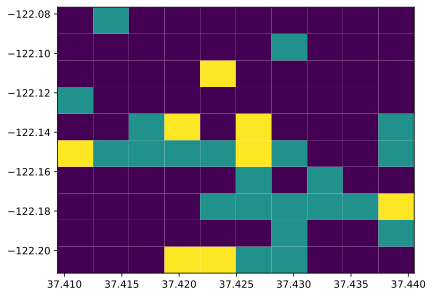

In [ ]:
plt.hist2d(gdf_chg_stn['latitude'], gdf_chg_stn['longitude'])

(array([1.126e+03, 0.000e+00, 0.000e+00, 2.000e+01, 0.000e+00, 0.000e+00,
        2.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([0. , 0.3, 0.6, 0.9, 1.2, 1.5, 1.8, 2.1, 2.4, 2.7, 3. ]),
 <BarContainer object of 10 artists>)

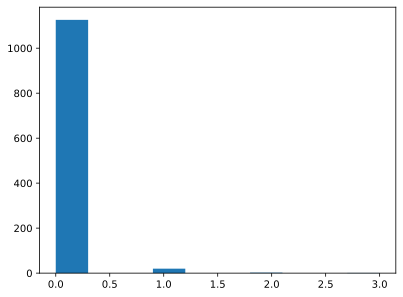

In [ ]:
plt.hist(df_TRT_join_chg['charging station'])

(array([1.14e+03, 0.00e+00, 0.00e+00, 0.00e+00, 0.00e+00, 8.00e+00,
        0.00e+00, 0.00e+00, 0.00e+00, 1.00e+00]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <BarContainer object of 10 artists>)

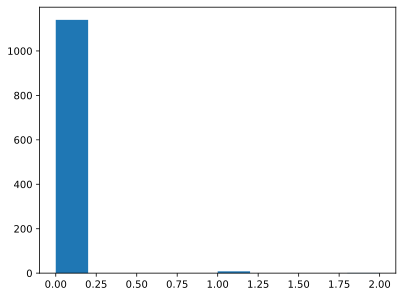

In [ ]:
plt.hist(df_TRT_join_chg['food court'])